# 테이블형 데이터 다루기

## 배열 만들기
- https://numpy.org/doc/stable/reference/generated/numpy.array.html

In [3]:
import numpy as np
numbers = np.array(range(1, 11), copy=True)
numbers

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10])

In [6]:
num = np.arange(1, 11)
print(num)

[ 1  2  3  4  5  6  7  8  9 10]


In [4]:
a = [1, 2, 3]
b = [4, 5, 6]
print(a + b)

a1 = np.array([1, 2, 3])
b1 = np.array([4, 5, 6])
print(a1 + b1)

[1, 2, 3, 4, 5, 6]
[5 7 9]


In [5]:
print(type(a1))

<class 'numpy.ndarray'>


## Array copy 만들기
- https://stackoverflow.com/questions/55074362/about-the-boolean-parameter-copy-in-np-array-function

In [2]:
a1 = np.array([1, 2, 3])
a2 = np.array(a1, copy=False)
a3 = np.array(a1, copy=True)

a1[0] = 50
print(f"a1: {a1}")
print(f"a2: {a2}")
print(f"a3: {a3}")

a1: [50  2  3]
a2: [50  2  3]
a3: [1 2 3]


In [3]:
x = np.array([1, 2, 3])
y = x
z = np.copy(x)

x[0] = 10
print(x[0] == y[0])
print(x[0] == z[0])

True
False


## Shallow copy, deep copy

In [7]:
a = np.array([1, 'm', [2, 3, 4]], dtype=object)
b = np.copy(a)
b[2][0] = 10

print(a)
print(b)

[1 'm' list([10, 3, 4])]
[1 'm' list([10, 3, 4])]


In [8]:
import copy
a = np.array([1, 'm', [2, 3, 4]], dtype=object)
c = copy.deepcopy(a)
c[2][0] = 10
print(a)
print(c)

[1 'm' list([2, 3, 4])]
[1 'm' list([10, 3, 4])]


## Array 만들기

In [9]:
ones = np.ones([2, 4], dtype=np.float64)
ones

array([[1., 1., 1., 1.],
       [1., 1., 1., 1.]])

In [10]:
zeros = np.zeros([2, 4], dtype=np.float64)
zeros

array([[0., 0., 0., 0.],
       [0., 0., 0., 0.]])

In [13]:
empty = np.empty([2, 4], dtype=np.float64)
# 배열의 내용물이 항상 0인 것은 아니다.
empty
# zeros와는 달리 array value를 0으로 세팅하지 않음. 약간 빠를 수 있음.

array([[1., 1., 1., 1.],
       [1., 1., 1., 1.]])

In [15]:
ones.shape # 아직 변형되지 않았다면 원래 모양을 반환한다.

(2, 4)

In [16]:
numbers.ndim # len(numbers.shape)와 같다.

1

In [14]:
zeros.dtype

dtype('float64')

In [17]:
eye = np.eye(3, k=1)
eye

array([[0., 1., 0.],
       [0., 0., 1.],
       [0., 0., 0.]])

In [18]:
np_numbers = np.arange(2, 5, 0.25)
np_numbers

array([2.  , 2.25, 2.5 , 2.75, 3.  , 3.25, 3.5 , 3.75, 4.  , 4.25, 4.5 ,
       4.75])

In [19]:
# np_inumbers = np_numbers.astype(np.int)
np_inumbers = np_numbers.astype(int)
np_inumbers

array([2, 2, 2, 2, 3, 3, 3, 3, 4, 4, 4, 4])

## 행/열 전환과 형태 변형하기

In [4]:
sap = np.array(["MMM", "ABT", "ABBV", "ACN", "ACE", "ATVI", "ADBE", "ADT"])
sap

array(['MMM', 'ABT', 'ABBV', 'ACN', 'ACE', 'ATVI', 'ADBE', 'ADT'],
      dtype='<U4')

In [5]:
sap2d = sap.reshape(2, 4)
sap2d

array([['MMM', 'ABT', 'ABBV', 'ACN'],
       ['ACE', 'ATVI', 'ADBE', 'ADT']], dtype='<U4')

In [6]:
sap2d = sap.reshape(2, -1)
sap2d

array([['MMM', 'ABT', 'ABBV', 'ACN'],
       ['ACE', 'ATVI', 'ADBE', 'ADT']], dtype='<U4')

In [27]:
sap2d_1 = np.reshape(sap, [2, 4])
sap2d_1

array([['MMM', 'ABT', 'ABBV', 'ACN'],
       ['ACE', 'ATVI', 'ADBE', 'ADT']], dtype='<U4')

In [19]:
sap3d = sap.reshape(2, 2, 2)
sap3d

array([[['MMM', 'ABT'],
        ['ABBV', 'ACN']],

       [['ACE', 'ATVI'],
        ['ADBE', 'ADT']]], dtype='<U4')

In [23]:
sap2d.T

array([['MMM', 'ACE'],
       ['ABT', 'ATVI'],
       ['ABBV', 'ADBE'],
       ['ACN', 'ADT']], dtype='<U4')

In [28]:
np.transpose(sap2d)

array([['MMM', 'ACE'],
       ['ABT', 'ATVI'],
       ['ABBV', 'ADBE'],
       ['ACN', 'ADT']], dtype='<U4')

In [24]:
sap3d.swapaxes(1, 2)

array([[['MMM', 'ABBV'],
        ['ABT', 'ACN']],

       [['ACE', 'ADBE'],
        ['ATVI', 'ADT']]], dtype='<U4')

In [25]:
sap3d.transpose((0, 2, 1))

array([[['MMM', 'ABBV'],
        ['ABT', 'ACN']],

       [['ACE', 'ADBE'],
        ['ATVI', 'ADT']]], dtype='<U4')

## 인덱싱과 자르기

In [15]:
dirty = np.array([9, 4, 1, -0.01, -0.02, -0.001])
whos_dirty = dirty < 0 # 불 배열을 불 인덱스로 사용한다.
whos_dirty

array([False, False, False,  True,  True,  True])

In [16]:
dirty[whos_dirty]

array([-0.01 , -0.02 , -0.001])

In [4]:
dirty[whos_dirty] = 0 # 모든 음수값을 0으로 바꾼다.
dirty

array([9., 4., 1., 0., 0., 0.])

In [5]:
# -0.5와 0.5 사이에 위치한 아이템은 무엇일까?
linear = np.arange(-1, 1.1, 0.2)
(linear <= 0.5) & (linear >= -0.5)
# <, <= 등과 같은 관계형 연산자는 &, |, !와 같은 비트 단위 연산자보다 처리순위가 떨어지므로
# 반드시 ()를 통해 우선순위를 설정해야 함.

array([False, False, False,  True,  True,  True,  True,  True, False,
       False, False])

### 스마트 인덱싱, 스마트 슬라이싱

In [10]:
sap

array(['MMM', 'ABT', 'ABBV', 'ACN', 'ACE', 'ATVI', 'ADBE', 'ADT'],
      dtype='<U4')

In [11]:
sap[[1, 2, -1]]

array(['ABT', 'ABBV', 'ADT'], dtype='<U4')

In [17]:
sap2d

array([['MMM', 'ABT', 'ABBV', 'ACN'],
       ['ACE', 'ATVI', 'ADBE', 'ADT']], dtype='<U4')

In [18]:
sap2d[:, 1]

array(['ABT', 'ATVI'], dtype='<U4')

In [16]:
sap2d[:, [1]]

array([['ABT'],
       ['ATVI']], dtype='<U4')

In [21]:
sap3d

array([[['MMM', 'ABT'],
        ['ABBV', 'ACN']],

       [['ACE', 'ATVI'],
        ['ADBE', 'ADT']]], dtype='<U4')

In [20]:
sap3d[0, ...]

array([['MMM', 'ABT'],
       ['ABBV', 'ACN']], dtype='<U4')

## 브로드캐스팅 (배열끼리의 벡터화된 사칙연산)

In [13]:
a = np.arange(4)
b = np.arange(1, 5)
a+b

array([1, 3, 5, 7])

In [22]:
c = [0, 1, 2, 3]
d = [1, 2, 3, 4]
c+d

[0, 1, 2, 3, 1, 2, 3, 4]

In [23]:
a*5

array([ 0,  5, 10, 15])

In [24]:
c*5

[0, 1, 2, 3, 0, 1, 2, 3, 0, 1, 2, 3, 0, 1, 2, 3, 0, 1, 2, 3]

In [25]:
noise = np.eye(4) + 0.01 * np.ones((4, ))
noise


noise = np.eye(4) + 0.01 * np.random.random([4, 4])
np.round(noise, 2)

array([[1.  , 0.01, 0.  , 0.01],
       [0.01, 1.01, 0.  , 0.  ],
       [0.01, 0.  , 1.01, 0.01],
       [0.  , 0.01, 0.  , 1.  ]])

## 유니버셜 함수
- https://numpy.org/doc/stable/reference/ufuncs.html#available-ufuncs

In [26]:
%%timeit

def test(values):
    size = len(values)
    output = np.empty(size)
    for i, value in enumerate(values):
        output[i] = 1.0 / value
    return output

values = np.random.randint(1, 100, size=1000)
result_inbuilt = test(values)
print(result_inbuilt)

[0.02380952 0.33333333 0.01408451 0.07692308 0.02040816 0.01075269
 0.01123596 0.01098901 0.01298701 0.05       0.02083333 0.08333333
 0.05263158 0.01785714 0.01298701 0.03846154 0.01219512 0.01351351
 0.01666667 0.07142857 0.01020408 0.04761905 0.01234568 0.01086957
 0.01639344 0.01923077 0.125      0.04166667 0.01388889 0.01515152
 0.03571429 0.03333333 0.04545455 0.11111111 0.02173913 0.01666667
 0.01538462 0.02631579 0.02702703 0.03846154 0.0106383  0.14285714
 0.01492537 0.33333333 0.02857143 0.04       0.02040816 0.01724138
 0.01587302 0.015625   0.01333333 0.01923077 0.03448276 0.01333333
 0.01136364 0.03333333 0.02272727 0.03030303 0.02173913 0.01449275
 0.0125     0.08333333 0.01136364 0.01428571 0.0106383  0.04545455
 0.01818182 0.0212766  0.01369863 0.01612903 0.01030928 0.02631579
 0.03571429 0.01515152 0.04166667 0.02083333 0.02083333 0.01075269
 0.02777778 0.01190476 0.05555556 0.09090909 0.02222222 0.03030303
 0.01282051 0.04761905 0.08333333 0.07692308 0.01492537 0.0666

In [27]:
%%timeit

values = np.random.randint(1, 100, size=1000)
result_vectorized = 1.0 / values
print(result_vectorized)

[0.04347826 0.02439024 0.16666667 0.01136364 0.04347826 0.02272727
 0.2        0.1        0.01818182 0.01538462 0.015625   0.01960784
 0.07142857 0.01041667 0.01086957 0.02325581 0.01315789 0.02564103
 0.01351351 0.01886792 0.01315789 0.01041667 0.14285714 0.02272727
 0.01204819 1.         0.01149425 0.03225806 0.125      0.01388889
 0.03030303 0.02941176 0.01111111 0.01639344 0.05263158 0.01388889
 0.01111111 0.01369863 1.         0.01886792 0.01265823 0.01886792
 0.01041667 0.01020408 0.025      0.03225806 0.01219512 0.01369863
 0.01388889 0.02439024 0.01098901 0.01098901 0.02941176 0.01818182
 0.01818182 0.01886792 0.01538462 0.01190476 0.05263158 0.05555556
 0.01923077 0.05882353 0.04545455 0.03571429 0.01162791 0.03703704
 0.01075269 0.01818182 0.03225806 0.01388889 0.01149425 0.02380952
 0.01470588 0.01030928 0.01149425 0.01515152 0.01408451 0.0212766
 0.02222222 0.01136364 0.01351351 0.11111111 0.02083333 0.07142857
 0.02325581 0.01408451 0.02941176 0.01612903 0.015625   0.02083

### E.g. isnan()

In [8]:
# 여덟 종목의 이틀간의 주가
stocks = np.array([140.49, 0.97, 40.68, 41.53, 55.7, 57.21, 98.2, 99.19, 109.96, 111.47, 35.71, 36.27, 87.85, 89.11, 30.22, 30.91])
stocks

array([140.49,   0.97,  40.68,  41.53,  55.7 ,  57.21,  98.2 ,  99.19,
       109.96, 111.47,  35.71,  36.27,  87.85,  89.11,  30.22,  30.91])

In [9]:
# Reshape를 통해 보기 좋게 가공
stocks = stocks.reshape(8, 2).T
stocks

array([[140.49,  40.68,  55.7 ,  98.2 , 109.96,  35.71,  87.85,  30.22],
       [  0.97,  41.53,  57.21,  99.19, 111.47,  36.27,  89.11,  30.91]])

In [30]:
fall = np.greater(stocks[0], stocks[1])
fall

array([ True, False, False, False, False, False, False, False])

In [31]:
# fall이라는 boolean array를 이용한 boolean indexing
sap[fall]

array(['MMM'], dtype='<U4')

In [32]:
# 새 MMM 주식 가격이 결측치라고 가정해보자.
stocks[1, 0] = np.nan
np.isnan(stocks)

array([[False, False, False, False, False, False, False, False],
       [ True, False, False, False, False, False, False, False]])

In [33]:
stocks[np.isnan(stocks)] = 0
stocks

array([[140.49,  40.68,  55.7 ,  98.2 , 109.96,  35.71,  87.85,  30.22],
       [  0.  ,  41.53,  57.21,  99.19, 111.47,  36.27,  89.11,  30.91]])

## 조건부 함수 이해하기

In [10]:
# 어떤 종목의 가격이 눈에 띄게 (즉, 1.00달러 이상) 변화했는지 알아보자.
# numpy.where
changes = np.where(np.abs(stocks[1] - stocks[0]) > 1.00,
                   stocks[1] - stocks[0], 0)
changes


array([-139.52,    0.  ,    1.51,    0.  ,    1.51,    0.  ,    1.26,
          0.  ])

In [11]:
# 할당한 주식기호를 출력하도록 해보자.
sap[np.nonzero(changes)]

array(['MMM', 'ABBV', 'ACE', 'ADBE'], dtype='<U4')

In [12]:
np.abs(stocks[1] - stocks[0]) > 1.00

array([ True, False,  True, False,  True, False,  True, False])

In [13]:
# Boolean indexing으로도 출력가능하다.
sap[np.abs(stocks[1] - stocks[0]) > 1.00]

array(['MMM', 'ABBV', 'ACE', 'ADBE'], dtype='<U4')

In [14]:
# 평균 수준보다 크게 변화한 주식을 추출해 보자.
sap[np.abs(stocks[0] - stocks[1]) > np.mean(np.abs(stocks[0] - stocks[1]))]

array(['MMM'], dtype='<U4')

## 배열 집계와 정렬

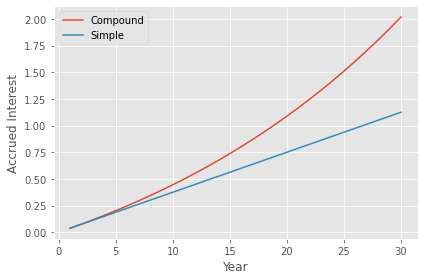

In [38]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib   # matplotlib은 나중에...

# 주어진 이자에 대한 단리/복리 이자비용을 출력해 보자.
RATE = .0375    # 3.75%
TERM = 30
simple = (RATE * np.ones(TERM)).cumsum()
compound = ((1 + RATE) * np.ones(TERM)).cumprod() - 1

matplotlib.style.use("ggplot")
t = np.arange(1, 31)
plt.plot(t, compound)
plt.plot(t, simple)
plt.legend(["Compound", "Simple"], loc=2)
plt.xlabel("Year")
plt.ylabel("Accrued Interest")
plt.tight_layout()
plt.savefig("interest.pdf")

## 배열을 집합처럼 다루기

In [39]:
# 배열 내 아이템의 순서보다, 배열의 내용물이 더 중요한 시나리오가 있다.
dna = "AGTCCGCGAATACAGGCTCGGT"
dna_as_array = np.array(list(dna))
dna_as_array

array(['A', 'G', 'T', 'C', 'C', 'G', 'C', 'G', 'A', 'A', 'T', 'A', 'C',
       'A', 'G', 'G', 'C', 'T', 'C', 'G', 'G', 'T'], dtype='<U1')

In [40]:
np.unique(dna_as_array)

array(['A', 'C', 'G', 'T'], dtype='<U1')

In [41]:
# "In one dimension"
np.in1d(["MSFT", "MMM", "AAPL"], sap)

array([False,  True, False])

In [42]:
np.intersect1d(["MSFT", "MMM", "AAPL"], sap)

array(['MMM'], dtype='<U4')

In [43]:
np.union1d(["MSFT", "MMM", "AAPL"], sap)

array(['AAPL', 'ABBV', 'ABT', 'ACE', 'ACN', 'ADBE', 'ADT', 'ATVI', 'MMM',
       'MSFT'], dtype='<U4')

## 합성 사인파 만들기

In [44]:
# 필요한 라이브러리를 불러온다.
import numpy as np
import matplotlib.pyplot as plt
import matplotlib

In [45]:
# 신호, 잡음, 그리고 "악기" 정보를 상수로 정의한다.
SIG_AMPLITUDE = 10; SIG_OFFSET = 2; SIG_PERIOD = 100
NOISE_AMPLITUDE = 3
N_SAMPLES = 5 * SIG_PERIOD
INSTRUMENT_RANGE = 9

In [46]:
# 사인 곡선을 구성하고 잡음을 섞어 넣는다.
times = np.arange(N_SAMPLES).astype(float)
signal = SIG_AMPLITUDE * np.sin(2 * np.pi * times / SIG_PERIOD) + SIG_OFFSET
noise = NOISE_AMPLITUDE * np.random.normal(size=N_SAMPLES)
signal += noise

In [47]:
# 음역대를 벗어난 스파이크를 제거한다.
signal[signal > INSTRUMENT_RANGE] = INSTRUMENT_RANGE
signal[signal < -INSTRUMENT_RANGE] = -INSTRUMENT_RANGE

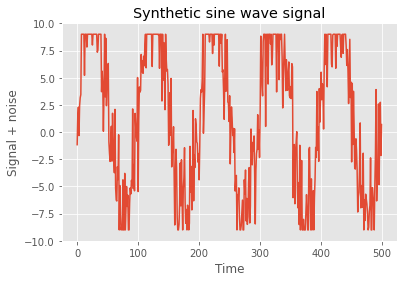

In [48]:
# 결과를 플롯(plot)으로 시각화한다.
matplotlib.style.use("ggplot")
plt.plot(times, signal)
plt.title("Synthetic sine wave signal")
plt.xlabel("Time")
plt.ylabel("Signal + noise")
plt.ylim(ymin = -SIG_AMPLITUDE, ymax = SIG_AMPLITUDE)

# 플롯을 저장한다.
plt.savefig("signal.pdf")